In [ ]:
!pip install kaggle --quiet
!pip install polars --quiet
!pip install matplotlib --quiet
!pip install plotly --quiet
!pip install missingno --quiet

In [ ]:
## We will download the datset

In [ ]:
! mkdir ~/.kaggle


In [ ]:
! cp kaggle.json ~/.kaggle/


In [ ]:
! chmod 600 ~/.kaggle/kaggle.json


In [ ]:
! kaggle competitions download store-sales-time-series-forecasting


 28% 6.00M/21.4M [00:00<00:00, 62.9MB/s]
100% 21.4M/21.4M [00:00<00:00, 118MB/s] 


In [ ]:
! mkdir train

In [ ]:
! unzip store-sales-time-series-forecasting.zip -d train



Archive:  store-sales-time-series-forecasting.zip
  inflating: train/holidays_events.csv  
  inflating: train/oil.csv           
  inflating: train/sample_submission.csv  
  inflating: train/stores.csv        
  inflating: train/test.csv          
  inflating: train/train.csv         
  inflating: train/transactions.csv  


In [ ]:
#! unzip train/train.csv.zip -d train


In [ ]:
## Importing the libraries

In [ ]:
import numpy
import random

In [369]:
import polars as pl
import numpy as np
import datetime
import pandas as pd
import missingno as msno
from sklearn.metrics import r2_score,mean_squared_error
##matplotlib
import plotly
from matplotlib.pyplot import rcParams
from sklearn.preprocessing import LabelEncoder
import plotly.express as px
from datetime import datetime
import warnings
warnings.filterwarnings("ignore")

from statsmodels.tsa.stattools import adfuller
#import pdarima as pm

In [ ]:
%matplotlib inline
import plotly.express as px
import matplotlib.pyplot as plt
plt.style.use('bmh')

In [ ]:
df = pl.read_csv("train/train.csv",has_header=True,ignore_errors=True,infer_schema_length=10000,try_parse_dates=True)
stores = pl.read_csv("train/stores.csv",has_header=True,ignore_errors=True,infer_schema_length=10000,try_parse_dates=True)
oil = pl.read_csv("train/oil.csv",has_header=True,ignore_errors=True,infer_schema_length=10000,try_parse_dates=True)
test = pl.read_csv("train/test.csv",has_header=True,ignore_errors=True,infer_schema_length=10000,try_parse_dates=True)
holidays = pl.read_csv("train/holidays_events.csv",has_header=True,ignore_errors=True,infer_schema_length=10000,try_parse_dates=True)

In [ ]:
print(df.head()) ## we have to join store dataframe with df

shape: (5, 6)
┌─────┬────────────┬───────────┬────────────┬───────┬─────────────┐
│ id  ┆ date       ┆ store_nbr ┆ family     ┆ sales ┆ onpromotion │
│ --- ┆ ---        ┆ ---       ┆ ---        ┆ ---   ┆ ---         │
│ i64 ┆ date       ┆ i64       ┆ str        ┆ f64   ┆ i64         │
╞═════╪════════════╪═══════════╪════════════╪═══════╪═════════════╡
│ 0   ┆ 2013-01-01 ┆ 1         ┆ AUTOMOTIVE ┆ 0.0   ┆ 0           │
│ 1   ┆ 2013-01-01 ┆ 1         ┆ BABY CARE  ┆ 0.0   ┆ 0           │
│ 2   ┆ 2013-01-01 ┆ 1         ┆ BEAUTY     ┆ 0.0   ┆ 0           │
│ 3   ┆ 2013-01-01 ┆ 1         ┆ BEVERAGES  ┆ 0.0   ┆ 0           │
│ 4   ┆ 2013-01-01 ┆ 1         ┆ BOOKS      ┆ 0.0   ┆ 0           │
└─────┴────────────┴───────────┴────────────┴───────┴─────────────┘


In [ ]:
print(type(df))

<class 'polars.dataframe.frame.DataFrame'>


In [ ]:
print(stores.head())

shape: (5, 5)
┌───────────┬───────────────┬────────────────────────────────┬──────┬─────────┐
│ store_nbr ┆ city          ┆ state                          ┆ type ┆ cluster │
│ ---       ┆ ---           ┆ ---                            ┆ ---  ┆ ---     │
│ i64       ┆ str           ┆ str                            ┆ str  ┆ i64     │
╞═══════════╪═══════════════╪════════════════════════════════╪══════╪═════════╡
│ 1         ┆ Quito         ┆ Pichincha                      ┆ D    ┆ 13      │
│ 2         ┆ Quito         ┆ Pichincha                      ┆ D    ┆ 13      │
│ 3         ┆ Quito         ┆ Pichincha                      ┆ D    ┆ 8       │
│ 4         ┆ Quito         ┆ Pichincha                      ┆ D    ┆ 9       │
│ 5         ┆ Santo Domingo ┆ Santo Domingo de los Tsachilas ┆ D    ┆ 4       │
└───────────┴───────────────┴────────────────────────────────┴──────┴─────────┘


In [ ]:
print(oil.head())

shape: (5, 2)
┌────────────┬────────────┐
│ date       ┆ dcoilwtico │
│ ---        ┆ ---        │
│ date       ┆ f64        │
╞════════════╪════════════╡
│ 2013-01-01 ┆ null       │
│ 2013-01-02 ┆ 93.14      │
│ 2013-01-03 ┆ 92.97      │
│ 2013-01-04 ┆ 93.12      │
│ 2013-01-07 ┆ 93.2       │
└────────────┴────────────┘


In [ ]:
print(holidays.head())

shape: (5, 6)
┌────────────┬─────────┬──────────┬─────────────┬───────────────────────────────┬─────────────┐
│ date       ┆ type    ┆ locale   ┆ locale_name ┆ description                   ┆ transferred │
│ ---        ┆ ---     ┆ ---      ┆ ---         ┆ ---                           ┆ ---         │
│ date       ┆ str     ┆ str      ┆ str         ┆ str                           ┆ bool        │
╞════════════╪═════════╪══════════╪═════════════╪═══════════════════════════════╪═════════════╡
│ 2012-03-02 ┆ Holiday ┆ Local    ┆ Manta       ┆ Fundacion de Manta            ┆ false       │
│ 2012-04-01 ┆ Holiday ┆ Regional ┆ Cotopaxi    ┆ Provincializacion de Cotopaxi ┆ false       │
│ 2012-04-12 ┆ Holiday ┆ Local    ┆ Cuenca      ┆ Fundacion de Cuenca           ┆ false       │
│ 2012-04-14 ┆ Holiday ┆ Local    ┆ Libertad    ┆ Cantonizacion de Libertad     ┆ false       │
│ 2012-04-21 ┆ Holiday ┆ Local    ┆ Riobamba    ┆ Cantonizacion de Riobamba     ┆ false       │
└────────────┴─────────┴──

In [ ]:
print(test.head())

shape: (5, 5)
┌─────────┬────────────┬───────────┬────────────┬─────────────┐
│ id      ┆ date       ┆ store_nbr ┆ family     ┆ onpromotion │
│ ---     ┆ ---        ┆ ---       ┆ ---        ┆ ---         │
│ i64     ┆ date       ┆ i64       ┆ str        ┆ i64         │
╞═════════╪════════════╪═══════════╪════════════╪═════════════╡
│ 3000888 ┆ 2017-08-16 ┆ 1         ┆ AUTOMOTIVE ┆ 0           │
│ 3000889 ┆ 2017-08-16 ┆ 1         ┆ BABY CARE  ┆ 0           │
│ 3000890 ┆ 2017-08-16 ┆ 1         ┆ BEAUTY     ┆ 2           │
│ 3000891 ┆ 2017-08-16 ┆ 1         ┆ BEVERAGES  ┆ 20          │
│ 3000892 ┆ 2017-08-16 ┆ 1         ┆ BOOKS      ┆ 0           │
└─────────┴────────────┴───────────┴────────────┴─────────────┘


In [ ]:
print(df.to_pandas().info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000888 entries, 0 to 3000887
Data columns (total 6 columns):
 #   Column       Dtype         
---  ------       -----         
 0   id           int64         
 1   date         datetime64[ns]
 2   store_nbr    int64         
 3   family       object        
 4   sales        float64       
 5   onpromotion  int64         
dtypes: datetime64[ns](1), float64(1), int64(3), object(1)
memory usage: 137.4+ MB
None


In [ ]:
print(df.describe())

shape: (9, 7)
┌────────────┬───────────────┬────────────┬────────────┬────────────┬─────────────┬─────────────┐
│ describe   ┆ id            ┆ date       ┆ store_nbr  ┆ family     ┆ sales       ┆ onpromotion │
│ ---        ┆ ---           ┆ ---        ┆ ---        ┆ ---        ┆ ---         ┆ ---         │
│ str        ┆ f64           ┆ str        ┆ f64        ┆ str        ┆ f64         ┆ f64         │
╞════════════╪═══════════════╪════════════╪════════════╪════════════╪═════════════╪═════════════╡
│ count      ┆ 3.000888e6    ┆ 3000888    ┆ 3.000888e6 ┆ 3000888    ┆ 3.000888e6  ┆ 3.000888e6  │
│ null_count ┆ 0.0           ┆ 0          ┆ 0.0        ┆ 0          ┆ 0.0         ┆ 0.0         │
│ mean       ┆ 1500443.5     ┆ null       ┆ 27.5       ┆ null       ┆ 357.775749  ┆ 2.60277     │
│ std        ┆ 866281.891642 ┆ null       ┆ 15.585787  ┆ null       ┆ 1101.997721 ┆ 12.218882   │
│ min        ┆ 0.0           ┆ 2013-01-01 ┆ 1.0        ┆ AUTOMOTIVE ┆ 0.0         ┆ 0.0         │
│ max 

<h2> Checking for the null values </h2>

<Axes: >

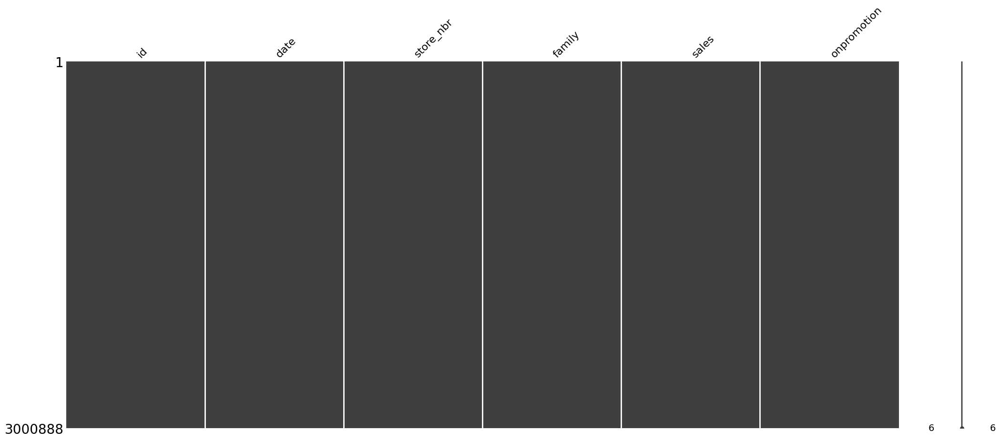

In [ ]:
msno.matrix(df.to_pandas())

In [ ]:
##We are going to drop the null values for now

In [ ]:
##counting the null values

In [ ]:
print(df.select(pl.all().is_null().sum()))


shape: (1, 6)
┌─────┬──────┬───────────┬────────┬───────┬─────────────┐
│ id  ┆ date ┆ store_nbr ┆ family ┆ sales ┆ onpromotion │
│ --- ┆ ---  ┆ ---       ┆ ---    ┆ ---   ┆ ---         │
│ u32 ┆ u32  ┆ u32       ┆ u32    ┆ u32   ┆ u32         │
╞═════╪══════╪═══════════╪════════╪═══════╪═════════════╡
│ 0   ┆ 0    ┆ 0         ┆ 0      ┆ 0     ┆ 0           │
└─────┴──────┴───────────┴────────┴───────┴─────────────┘


<h2> Dealing with the categorical values </h2>

In [ ]:
print(df.head(3))

shape: (3, 6)
┌─────┬────────────┬───────────┬────────────┬───────┬─────────────┐
│ id  ┆ date       ┆ store_nbr ┆ family     ┆ sales ┆ onpromotion │
│ --- ┆ ---        ┆ ---       ┆ ---        ┆ ---   ┆ ---         │
│ i64 ┆ date       ┆ i64       ┆ str        ┆ f64   ┆ i64         │
╞═════╪════════════╪═══════════╪════════════╪═══════╪═════════════╡
│ 0   ┆ 2013-01-01 ┆ 1         ┆ AUTOMOTIVE ┆ 0.0   ┆ 0           │
│ 1   ┆ 2013-01-01 ┆ 1         ┆ BABY CARE  ┆ 0.0   ┆ 0           │
│ 2   ┆ 2013-01-01 ┆ 1         ┆ BEAUTY     ┆ 0.0   ┆ 0           │
└─────┴────────────┴───────────┴────────────┴───────┴─────────────┘


<h2> We are going merge the store with train dataset </h2>

In [ ]:
df = df.join(stores,on="store_nbr")

In [ ]:
df = df.join(holidays,on="date")

In [ ]:
#df = df.join(oil,on="date") ## we are not merging oil as it has null values

In [ ]:
print(df.head(2))

shape: (2, 15)
┌─────┬────────────┬───────────┬────────────┬───┬──────────┬───────────┬─────────────┬─────────────┐
│ id  ┆ date       ┆ store_nbr ┆ family     ┆ … ┆ locale   ┆ locale_na ┆ description ┆ transferred │
│ --- ┆ ---        ┆ ---       ┆ ---        ┆   ┆ ---      ┆ me        ┆ ---         ┆ ---         │
│ i64 ┆ date       ┆ i64       ┆ str        ┆   ┆ str      ┆ ---       ┆ str         ┆ bool        │
│     ┆            ┆           ┆            ┆   ┆          ┆ str       ┆             ┆             │
╞═════╪════════════╪═══════════╪════════════╪═══╪══════════╪═══════════╪═════════════╪═════════════╡
│ 0   ┆ 2013-01-01 ┆ 1         ┆ AUTOMOTIVE ┆ … ┆ National ┆ Ecuador   ┆ Primer dia  ┆ false       │
│     ┆            ┆           ┆            ┆   ┆          ┆           ┆ del ano     ┆             │
│ 1   ┆ 2013-01-01 ┆ 1         ┆ BABY CARE  ┆ … ┆ National ┆ Ecuador   ┆ Primer dia  ┆ false       │
│     ┆            ┆           ┆            ┆   ┆          ┆           ┆ del

In [ ]:
print(df.describe())

shape: (9, 16)
┌───────────┬───────────┬───────────┬───────────┬───┬──────────┬───────────┬───────────┬───────────┐
│ describe  ┆ id        ┆ date      ┆ store_nbr ┆ … ┆ locale   ┆ locale_na ┆ descripti ┆ transferr │
│ ---       ┆ ---       ┆ ---       ┆ ---       ┆   ┆ ---      ┆ me        ┆ on        ┆ ed        │
│ str       ┆ f64       ┆ str       ┆ f64       ┆   ┆ str      ┆ ---       ┆ ---       ┆ ---       │
│           ┆           ┆           ┆           ┆   ┆          ┆ str       ┆ str       ┆ f64       │
╞═══════════╪═══════════╪═══════════╪═══════════╪═══╪══════════╪═══════════╪═══════════╪═══════════╡
│ count     ┆ 502524.0  ┆ 502524    ┆ 502524.0  ┆ … ┆ 502524   ┆ 502524    ┆ 502524    ┆ 502524.0  │
│ null_coun ┆ 0.0       ┆ 0         ┆ 0.0       ┆ … ┆ 0        ┆ 0         ┆ 0         ┆ 0.0       │
│ t         ┆           ┆           ┆           ┆   ┆          ┆           ┆           ┆           │
│ mean      ┆ 1.6075e6  ┆ null      ┆ 27.5      ┆ … ┆ null     ┆ null      ┆

In [ ]:
## Label encoder for City, State and Type

In [ ]:
df.columns

['id',
 'date',
 'store_nbr',
 'family',
 'sales',
 'onpromotion',
 'city',
 'state',
 'type',
 'cluster',
 'type_right',
 'locale',
 'locale_name',
 'description',
 'transferred']

In [ ]:
LE_city =  LabelEncoder()
LE_state = LabelEncoder()
LE_type = LabelEncoder()
LE_family = LabelEncoder()
LE_locale = LabelEncoder()
LE_type_right = LabelEncoder()
LE_locale_name = LabelEncoder()
LE_transfer_obj = LabelEncoder()

In [ ]:
##type casting  " transferred" from bool to time
df = df.select(
    pl.col("transferred").cast(pl.Int8).alias("transferred_int"),
    pl.all()
)

In [ ]:
df.head(2)

id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,type_right,locale,locale_name,description,transferred
i64,date,i64,str,f64,i64,str,str,str,i64,str,str,str,str,bool
0,2013-01-01,1,"""AUTOMOTIVE""",0.0,0,"""Quito""","""Pichincha""","""D""",13,"""Holiday""","""National""","""Ecuador""","""Primer dia del…",false
1,2013-01-01,1,"""BABY CARE""",0.0,0,"""Quito""","""Pichincha""","""D""",13,"""Holiday""","""National""","""Ecuador""","""Primer dia del…",false


In [ ]:

df = df.with_columns(
    city_int =  pl.lit(LE_city.fit_transform(df['city'])),
    state_int = pl.lit(LE_state.fit_transform(df['state'])),
    type_id = pl.lit(LE_type.fit_transform(df['type'])),
    type_right_int = pl.lit(LE_type_right.fit_transform(df['type_right'])),
    locale_int = pl.lit(LE_locale.fit_transform(df['locale'])),
    family_int =  pl.lit(LE_family.fit_transform(df['family'])),
    locale_name_int = pl.lit(LE_locale_name.fit_transform(df['locale_name'])))

In [ ]:
print(df.columns)

['id', 'date', 'store_nbr', 'family', 'sales', 'onpromotion', 'city', 'state', 'type', 'cluster', 'type_right', 'locale', 'locale_name', 'description', 'transferred']


In [ ]:
df_non_cat = df.drop(["family","city","state","type","locale","type_right"])

In [ ]:
#df = df.drop(['locale_name','description'])

In [ ]:
print(df.head(2))

shape: (2, 21)
┌─────┬────────────┬───────────┬────────────┬───┬─────────┬───────────────┬───────────┬───────────┐
│ id  ┆ date       ┆ store_nbr ┆ family     ┆ … ┆ type_id ┆ type_right_id ┆ locale_id ┆ family_id │
│ --- ┆ ---        ┆ ---       ┆ ---        ┆   ┆ ---     ┆ ---           ┆ ---       ┆ ---       │
│ i64 ┆ date       ┆ i64       ┆ str        ┆   ┆ i64     ┆ i64           ┆ i64       ┆ i64       │
╞═════╪════════════╪═══════════╪════════════╪═══╪═════════╪═══════════════╪═══════════╪═══════════╡
│ 0   ┆ 2013-01-01 ┆ 1         ┆ AUTOMOTIVE ┆ … ┆ 3       ┆ 3             ┆ 1         ┆ 0         │
│ 1   ┆ 2013-01-01 ┆ 1         ┆ BABY CARE  ┆ … ┆ 3       ┆ 3             ┆ 1         ┆ 1         │
└─────┴────────────┴───────────┴────────────┴───┴─────────┴───────────────┴───────────┴───────────┘


<h2> EDA </h2>

In [ ]:
print(df.tail())

shape: (5, 21)
┌─────────┬────────────┬───────────┬────────────┬───┬─────────┬────────────┬───────────┬───────────┐
│ id      ┆ date       ┆ store_nbr ┆ family     ┆ … ┆ type_id ┆ type_right ┆ locale_id ┆ family_id │
│ ---     ┆ ---        ┆ ---       ┆ ---        ┆   ┆ ---     ┆ _id        ┆ ---       ┆ ---       │
│ i64     ┆ date       ┆ i64       ┆ str        ┆   ┆ i64     ┆ ---        ┆ i64       ┆ i64       │
│         ┆            ┆           ┆            ┆   ┆         ┆ i64        ┆           ┆           │
╞═════════╪════════════╪═══════════╪════════════╪═══╪═════════╪════════════╪═══════════╪═══════════╡
│ 3000883 ┆ 2017-08-15 ┆ 9         ┆ POULTRY    ┆ … ┆ 1       ┆ 3          ┆ 0         ┆ 28        │
│ 3000884 ┆ 2017-08-15 ┆ 9         ┆ PREPARED   ┆ … ┆ 1       ┆ 3          ┆ 0         ┆ 29        │
│         ┆            ┆           ┆ FOODS      ┆   ┆         ┆            ┆           ┆           │
│ 3000885 ┆ 2017-08-15 ┆ 9         ┆ PRODUCE    ┆ … ┆ 1       ┆ 3          ┆

<h2> We are going to plot the graphs </h2>

Text(0, 0.5, 'Sales')

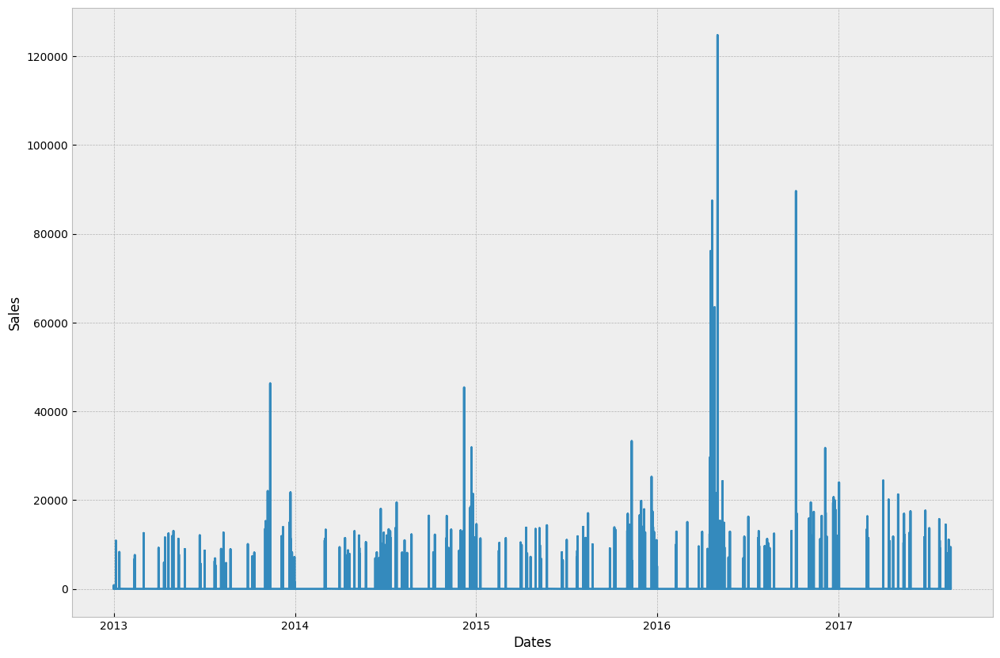

In [ ]:
plt.style.use('bmh')
plt.figure(figsize=(15,10))
plt.plot(df["date"],df["sales"])
plt.xlabel("Dates")
plt.ylabel(f"Sales")


In [ ]:
print(df.filter(pl.col('date') < datetime(2013,1,2) ).head(5))

shape: (5, 21)
┌─────┬────────────┬───────────┬────────────┬───┬─────────┬───────────────┬───────────┬───────────┐
│ id  ┆ date       ┆ store_nbr ┆ family     ┆ … ┆ type_id ┆ type_right_id ┆ locale_id ┆ family_id │
│ --- ┆ ---        ┆ ---       ┆ ---        ┆   ┆ ---     ┆ ---           ┆ ---       ┆ ---       │
│ i64 ┆ date       ┆ i64       ┆ str        ┆   ┆ i64     ┆ i64           ┆ i64       ┆ i64       │
╞═════╪════════════╪═══════════╪════════════╪═══╪═════════╪═══════════════╪═══════════╪═══════════╡
│ 0   ┆ 2013-01-01 ┆ 1         ┆ AUTOMOTIVE ┆ … ┆ 3       ┆ 3             ┆ 1         ┆ 0         │
│ 1   ┆ 2013-01-01 ┆ 1         ┆ BABY CARE  ┆ … ┆ 3       ┆ 3             ┆ 1         ┆ 1         │
│ 2   ┆ 2013-01-01 ┆ 1         ┆ BEAUTY     ┆ … ┆ 3       ┆ 3             ┆ 1         ┆ 2         │
│ 3   ┆ 2013-01-01 ┆ 1         ┆ BEVERAGES  ┆ … ┆ 3       ┆ 3             ┆ 1         ┆ 3         │
│ 4   ┆ 2013-01-01 ┆ 1         ┆ BOOKS      ┆ … ┆ 3       ┆ 3             ┆ 1        

Text(0, 0.5, 'Sales')

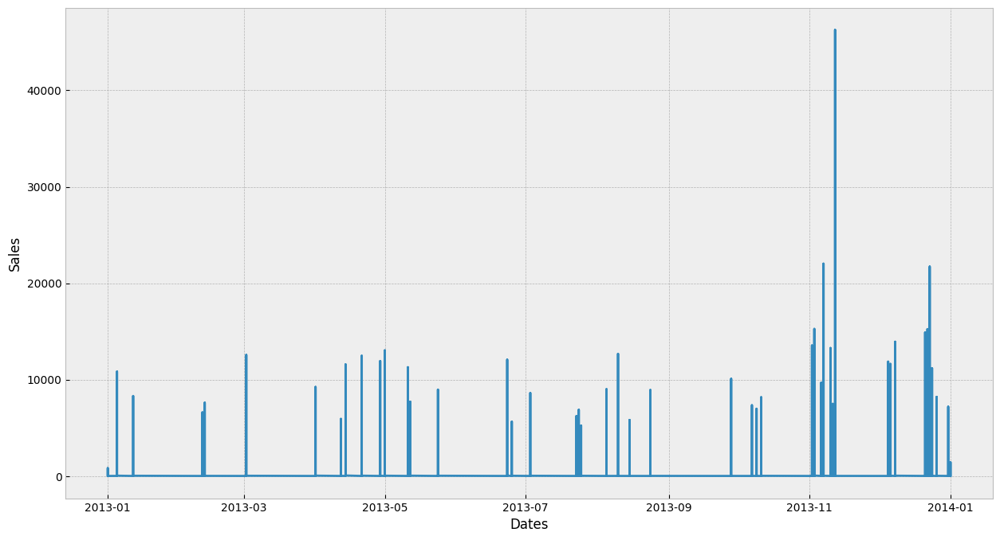

In [ ]:

plt.style.use('bmh')
plt.figure(figsize=(15,8))
plt.plot(df.filter(pl.col('date') < datetime(2014,2,9 ) )['date'],df.filter(pl.col('date') < datetime(2014,2,9 ) )['sales'])
plt.xlabel("Dates")
plt.ylabel(f"Sales")

In [ ]:
##plot ly
query_df = df.filter(pl.col('date') < datetime(2014,2,9 ) )

fig = px.line(query_df, x="date", y="sales",color="store_nbr", title='sales by date')
fig.show()

In [ ]:
print(df.columns)

['id', 'date', 'store_nbr', 'family', 'sales', 'onpromotion', 'city', 'state', 'type', 'cluster', 'type_right', 'locale', 'locale_name', 'description', 'transferred', 'city_id', 'state_id', 'type_id', 'type_right_id', 'locale_id', 'family_id']


In [ ]:
query_df = df.filter(pl.col('date') < datetime(2014,2,9 ) )

fig = px.line(query_df, x="family", y="sales",color="city", title='type')
fig.show()


In [ ]:
## Sales by Family
fig = px.histogram(query_df, x="family", y="sales",color="city", title='type')
fig.show()

In [ ]:
## State wise

In [ ]:
## Line Graph showing sales by family
fig = px.line(df, x="family", y="sales",color="state", title='type')
fig.show()


In [ ]:
## Line Graph showing sales by family
fig = px.line(query_df, x="state", y="sales", title='type')
fig.show()

In [ ]:
fig = px.histogram(query_df, x="family", y="sales",color="state", title='type')
fig.show()

In [ ]:
fig = px.histogram(query_df, x="state", y="sales",color="family", title='type')
fig.show()

In [ ]:
print(df.groupby('date').agg(pl.col("sales").count()))

shape: (252, 2)
┌────────────┬───────┐
│ date       ┆ sales │
│ ---        ┆ ---   │
│ date       ┆ u32   │
╞════════════╪═══════╡
│ 2014-04-12 ┆ 1782  │
│ 2015-12-31 ┆ 1782  │
│ 2014-12-20 ┆ 1782  │
│ 2014-05-10 ┆ 1782  │
│ …          ┆ …     │
│ 2014-03-04 ┆ 1782  │
│ 2017-07-24 ┆ 1782  │
│ 2013-11-10 ┆ 1782  │
│ 2013-06-25 ┆ 5346  │
└────────────┴───────┘


In [ ]:
print(df.groupby('date').agg(pl.col("sales").count()))

shape: (252, 2)
┌────────────┬───────┐
│ date       ┆ sales │
│ ---        ┆ ---   │
│ date       ┆ u32   │
╞════════════╪═══════╡
│ 2015-01-01 ┆ 1782  │
│ 2014-12-20 ┆ 1782  │
│ 2014-07-09 ┆ 1782  │
│ 2014-11-28 ┆ 1782  │
│ …          ┆ …     │
│ 2015-06-23 ┆ 1782  │
│ 2017-01-01 ┆ 1782  │
│ 2015-01-02 ┆ 1782  │
│ 2015-04-12 ┆ 1782  │
└────────────┴───────┘


In [ ]:
##to plot the scatter plot we need an mean sales  by each date
query_df = df.groupby('date').agg(pl.col("sales").mean())

fig = px.scatter(query_df, x="date", y="sales", title='sales by date')
fig.show()

In [ ]:
##to plot the histogram plot we need an mean sales  by each date
query_df = df.groupby('date').agg(pl.col("sales").mean())

fig = px.histogram(query_df, x="date", y="sales", title='sales by date')
fig.show()

<h3> Utils.py function </h3>

In [ ]:
# max family seling item
df.groupby('family').agg(
    pl.col("sales").sum()
).sort('sales',descending=True)[0]


family,sales
str,f64
"""GROCERY I""",6.3789e7


<h2> State wise Analysis </h2>

In [ ]:
# State wise analysis

query_df =df.groupby('state').agg(
    pl.col("sales").sum()
).sort('sales',descending=True)[0]
print(query_df) # state with max sales

filter_df = df.filter(
    pl.col('state') =="Pichincha"
)
filter_df.groupby('family').agg(
    pl.col("sales").sum() ,
  (( pl.col("sales").sum() /query_df['sales'][0]   )  * 100).alias("sales_percentage"),
    ).sort('sales',descending=True).head(5) # top 5 family items of sales

shape: (1, 2)
┌───────────┬──────────┐
│ state     ┆ sales    │
│ ---       ┆ ---      │
│ str       ┆ f64      │
╞═══════════╪══════════╡
│ Pichincha ┆ 1.0790e8 │
└───────────┴──────────┘


family,sales,sales_percentage
str,f64,f64
"""GROCERY I""",3.3481e7,31.027896
"""BEVERAGES""",2.1895547e7,20.291514
"""PRODUCE""",1.3949e7,12.926809
"""CLEANING""",8.440448e6,7.822114
"""DAIRY""",6.632201e6,6.146336


In [ ]:

query_df =df.groupby('state').agg(
    pl.col("sales").sum()
).sort('sales',descending=True)[2]
print(query_df) # state with max sales

filter_df = df.filter(
    pl.col('state') =="Azuay"
)
filter_df.groupby('family').agg(
    pl.col("sales").sum() ,
  (( pl.col("sales").sum() /query_df['sales'][0]   )  * 100).alias("sales_percentage"),
    ).sort('sales',descending=True).head(5) # top 5 family items of sales

shape: (1, 2)
┌───────┬──────────┐
│ state ┆ sales    │
│ ---   ┆ ---      │
│ str   ┆ f64      │
╞═══════╪══════════╡
│ Azuay ┆ 8.8591e6 │
└───────┴──────────┘


family,sales,sales_percentage
str,f64,f64
"""GROCERY I""",2.7860e6,31.447999
"""BEVERAGES""",1.654743e6,18.678368
"""PRODUCE""",1.2447e6,14.04989
"""CLEANING""",771016.0,8.703056
"""DAIRY""",523883.0,5.913474


In [ ]:
query_df['sales']

107904946.18882164

<h2> City Level </h2>

In [ ]:
query_df =df.groupby('city').agg(
    pl.col("sales").sum(),
).sort('sales',descending=True)[0]
print(query_df) # state with max sales

filter_df = df.filter(
    pl.col('city') =="Quito"
)
filter_df.groupby('family').agg(
    pl.col("sales").sum() ,
  (( pl.col("sales").sum() /query_df['sales'][0]   )  * 100).alias("sales_percentage"),
    ).sort('sales',descending=True).head(5) # top 5 family items of sales

shape: (1, 2)
┌───────┬──────────┐
│ city  ┆ sales    │
│ ---   ┆ ---      │
│ str   ┆ f64      │
╞═══════╪══════════╡
│ Quito ┆ 1.0276e8 │
└───────┴──────────┘


family,sales,sales_percentage
str,f64,f64
"""GROCERY I""",3.1460e7,30.614075
"""BEVERAGES""",2.0771454e7,20.212889
"""PRODUCE""",1.3698e7,13.330074
"""CLEANING""",7.872767e6,7.661061
"""DAIRY""",6.473846e6,6.299758


<h2> Store wise analysis

In [ ]:
## store

In [ ]:
query_df =df.groupby('store_nbr').agg(
    pl.col("sales").sum(),
).sort('sales',descending=True)[0]
print(query_df) # state with max sales

filter_df = df.filter(
    pl.col('store_nbr') ==44
)
filter_df.groupby('family').agg(
    pl.col("sales").sum() ,
  (( pl.col("sales").sum() /query_df['sales'][0]   )  * 100).alias("sales_percentage"),
    ).sort('sales',descending=True).head(5) # top 5 family items of sales

shape: (1, 2)
┌───────────┬──────────┐
│ store_nbr ┆ sales    │
│ ---       ┆ ---      │
│ i64       ┆ f64      │
╞═══════════╪══════════╡
│ 44        ┆ 1.1315e7 │
└───────────┴──────────┘


family,sales,sales_percentage
str,f64,f64
"""GROCERY I""",3.0342e6,26.815741
"""BEVERAGES""",2.443144e6,21.592062
"""PRODUCE""",1.9675e6,17.388183
"""DAIRY""",755108.0,6.673507
"""CLEANING""",736898.0,6.51257


In [ ]:
##cluster

In [ ]:
query_df =df.groupby('cluster').agg(
    pl.col("sales").sum(),
).sort('sales',descending=True)[0]
print(query_df) # state with max sales

filter_df = df.filter(
    pl.col('cluster') ==14
)
filter_df.groupby('family').agg(
    pl.col("sales").sum() ,
  (( pl.col("sales").sum() /query_df['sales'][0]   )  * 100).alias("sales_percentage"),
    ).sort('sales',descending=True).head(5) # top 5 family items of sales

shape: (1, 2)
┌─────────┬──────────┐
│ cluster ┆ sales    │
│ ---     ┆ ---      │
│ i64     ┆ f64      │
╞═════════╪══════════╡
│ 14      ┆ 2.9703e7 │
└─────────┴──────────┘


family,sales,sales_percentage
str,f64,f64
"""GROCERY I""",9.9890e6,33.629545
"""BEVERAGES""",5.633158e6,18.964825
"""PRODUCE""",2.8063e6,9.447655
"""CLEANING""",2.57414e6,8.666207
"""DAIRY""",1.746428e6,5.879598


In [ ]:
df.head(1)

id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,type_right,locale,locale_name,description,transferred,city_id,state_id,type_id,type_right_id,locale_id,family_id
i64,date,i64,str,f64,i64,str,str,str,i64,str,str,str,str,bool,i64,i64,i64,i64,i64,i64
0,2013-01-01,1,"""AUTOMOTIVE""",0.0,0,"""Quito""","""Pichincha""","""D""",13,"""Holiday""","""National""","""Ecuador""","""Primer dia del…",false,18,12,3,3,1,0


In [ ]:
print(df.columns)

['id', 'date', 'store_nbr', 'family', 'sales', 'onpromotion', 'city', 'state', 'type', 'cluster', 'type_right', 'locale', 'locale_name', 'description', 'transferred', 'city_id', 'state_id', 'type_id', 'type_right_id', 'locale_id', 'family_id']


In [ ]:
query_df = df.filter(pl.col('date') < datetime(2014,2,9 ) )

fig = px.histogram(query_df, x="date", y="sales", title='sales by date')
fig.show()

In [ ]:
query_df = df.groupby('date').agg(pl.col("sales").mean())

fig = px.histogram(query_df, x="date", y="sales", title='sales by date')
fig.show()

In [ ]:
df.groupby(["date"]).count().head(5)

date,count
date,u32
2015-11-03,1782
2013-04-01,1782
2014-08-10,1782
2013-12-21,1782
2014-05-10,1782


Text(0, 0.5, 'Sales')

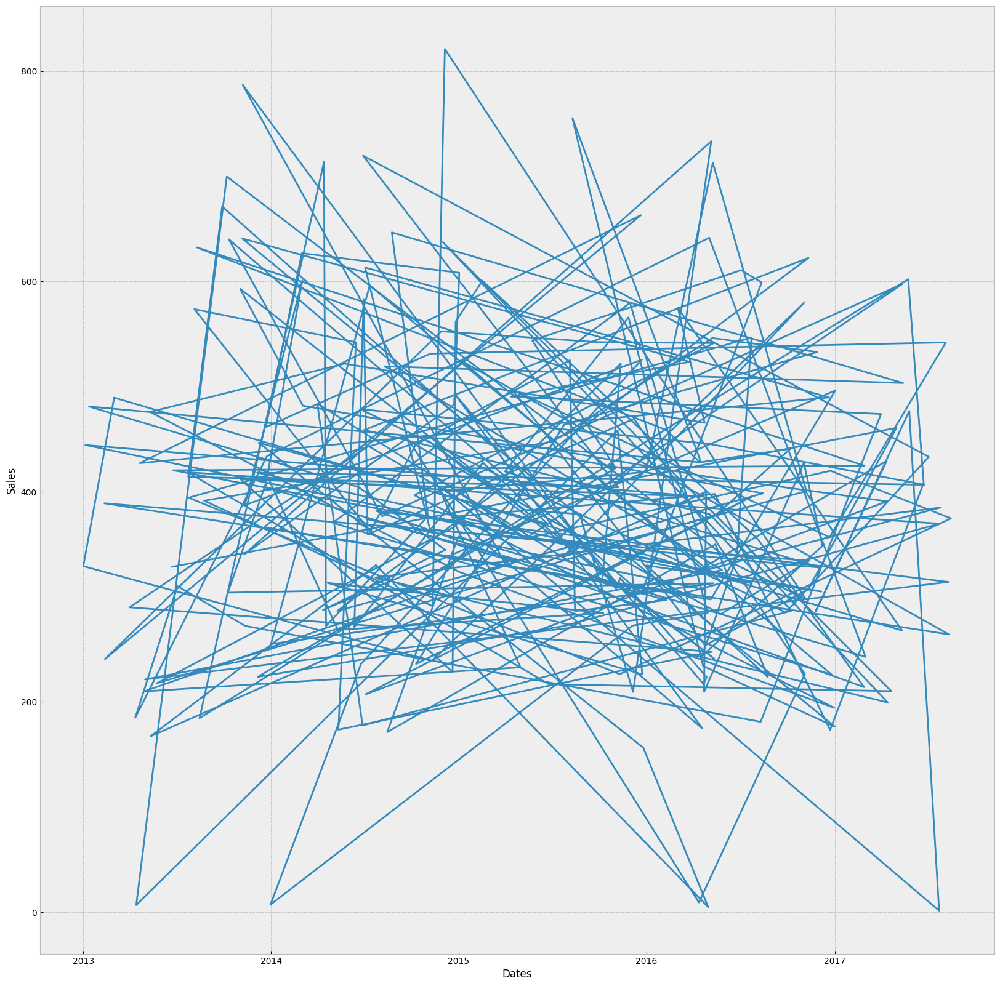

In [ ]:
plt.style.use('bmh')
plt.figure(figsize=(20,20))
plt.plot(df_non_cat.groupby("date").agg(pl.col('sales').mean())['date'],df_non_cat.groupby("date").agg(pl.col('sales').mean())['sales'])
plt.xlabel("Dates")
plt.ylabel(f"Sales")

In [ ]:
df_non_cat  = df_non_cat.sort('date')

In [ ]:
df_non_cat.head(2)

id,date,store_nbr,sales,onpromotion,cluster,locale_name,description,transferred,city_id,state_id,type_id,type_right_id,locale_id,family_id
i64,date,i64,f64,i64,i64,str,str,bool,i64,i64,i64,i64,i64,i64
0,2013-01-01,1,0.0,0,13,"""Ecuador""","""Primer dia del…",false,18,12,3,3,1,0
1,2013-01-01,1,0.0,0,13,"""Ecuador""","""Primer dia del…",false,18,12,3,3,1,1


In [ ]:
from datetime import datetime

Text(0, 0.5, 'Sales')

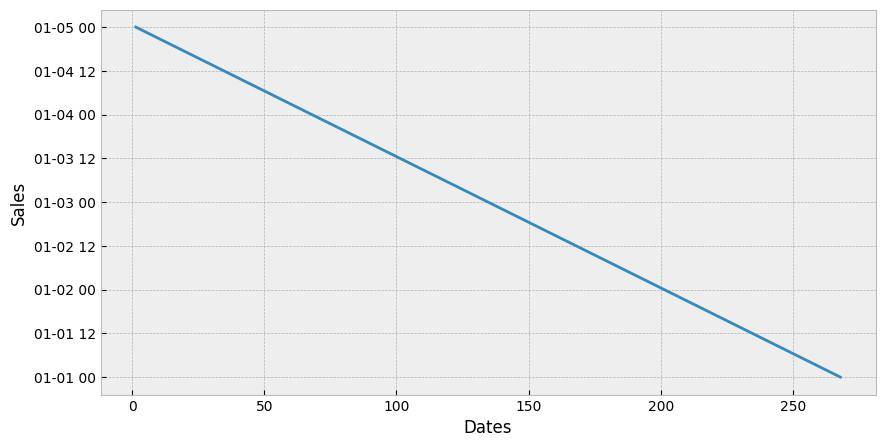

In [ ]:
plt.style.use('bmh')
plt.figure(figsize=(10,5))
plt.plot(df_non_cat.filter(pl.col('date') < datetime(2013,1,10) ).groupby("date").agg(pl.col('sales').mean())['sales'],(df_non_cat.filter(pl.col('date') < datetime(2013,1,10) ).groupby("date").agg(pl.col('sales').mean())['date']))
plt.xlabel("Dates")
plt.ylabel(f"Sales")

In [ ]:
## Store wise max sales on date

In [ ]:
query_df = df.groupby('date').agg(pl.col("sales").mean())

In [ ]:
store_grup_df = df.groupby(['store_nbr','date']).agg(pl.all() )
store_grup_df = df.groupby(['store_nbr','date']).agg(pl.all() )

In [ ]:
print(store_grup_df.columns)

['store_nbr', 'date', 'id', 'family', 'sales', 'onpromotion', 'city', 'state', 'type', 'cluster', 'type_right', 'locale', 'locale_name', 'description', 'transferred', 'city_id', 'state_id', 'type_id', 'type_right_id', 'locale_id', 'family_id']


In [ ]:
print(store_grup_df.columns)


['store_nbr', 'date', 'id', 'family', 'sales', 'onpromotion', 'city', 'state', 'type', 'cluster', 'type_right', 'locale', 'locale_name', 'description', 'transferred', 'city_id', 'state_id', 'type_id', 'type_right_id', 'locale_id', 'family_id']


In [ ]:
set(dataset['locale_name'].to_list())

In [ ]:
print(store_grup_df['sales'])

shape: (13_608,)
Series: 'sales' [list[f64]]
[
	[10.0, 0.0, … 29.439001]
	[2.0, 0.0, … 5.0]
	[2.0, 0.0, … 0.0]
	[12.0, 0.0, … 8.0]
	[23.0, 0.0, … 88.705]
	[13.0, 1.0, … 1.0]
	[4.0, 0.0, … 6.0]
	[15.0, 0.0, … 16.109001]
	[2.0, 0.0, … 58.128998]
	[2.0, 0.0, … 5.0629997]
	[4.0, 0.0, … 0.0]
	[10.0, 0.0, … 4.0]
	…
	[22.0, 22.0, … 70.169]
	[11.0, 0.0, … 0.0]
	[3.0, 0.0, … 1.0]
	[8.0, 0.0, … 64.029]
	[6.0, 0.0, … 35.609]
	[0.0, 0.0, … 0.0]
	[0.0, 0.0, … 0.0]
	[14.0, 1.0, … 24.0]
	[1.0, 0.0, … 31.276]
	[2.0, 2.0, … 21.947]
	[7.0, 0.0, … 28.872]
	[1.0, 1.0, … 117.809]
	[2.0, 2.0, … 1.0]
]


In [ ]:
store_grup_df.head()

store_nbr,date,id,family,sales,onpromotion,city,state,type,cluster,type_right,locale,locale_name,description,transferred,city_id,state_id,type_id,type_right_id,locale_id,family_id
i64,date,list[i64],list[str],list[f64],list[i64],list[str],list[str],list[str],list[i64],list[str],list[str],list[str],list[str],list[bool],list[i64],list[i64],list[i64],list[i64],list[i64],list[i64]
8,2016-04-19,"[2141898, 2141899, … 2141930]","[""AUTOMOTIVE"", ""BABY CARE"", … ""SEAFOOD""]","[10.0, 0.0, … 29.439001]","[0, 0, … 0]","[""Quito"", ""Quito"", … ""Quito""]","[""Pichincha"", ""Pichincha"", … ""Pichincha""]","[""D"", ""D"", … ""D""]","[8, 8, … 8]","[""Event"", ""Event"", … ""Event""]","[""National"", ""National"", … ""National""]","[""Ecuador"", ""Ecuador"", … ""Ecuador""]","[""Terremoto Manabi+3"", ""Terremoto Manabi+3"", … ""Terremoto Manabi+3""]","[false, false, … false]","[18, 18, … 18]","[12, 12, … 12]","[3, 3, … 3]","[2, 2, … 2]","[1, 1, … 1]","[0, 1, … 32]"
19,2016-04-28,"[2156550, 2156551, … 2156582]","[""AUTOMOTIVE"", ""BABY CARE"", … ""SEAFOOD""]","[2.0, 0.0, … 5.0]","[0, 0, … 0]","[""Guaranda"", ""Guaranda"", … ""Guaranda""]","[""Bolivar"", ""Bolivar"", … ""Bolivar""]","[""C"", ""C"", … ""C""]","[15, 15, … 15]","[""Event"", ""Event"", … ""Event""]","[""National"", ""National"", … ""National""]","[""Ecuador"", ""Ecuador"", … ""Ecuador""]","[""Terremoto Manabi+12"", ""Terremoto Manabi+12"", … ""Terremoto Manabi+12""]","[false, false, … false]","[7, 7, … 7]","[1, 1, … 1]","[2, 2, … 2]","[2, 2, … 2]","[1, 1, … 1]","[0, 1, … 32]"
12,2014-07-09,"[985545, 985546, … 985577]","[""AUTOMOTIVE"", ""BABY CARE"", … ""SEAFOOD""]","[2.0, 0.0, … 0.0]","[0, 0, … 0]","[""Latacunga"", ""Latacunga"", … ""Latacunga""]","[""Cotopaxi"", ""Cotopaxi"", … ""Cotopaxi""]","[""C"", ""C"", … ""C""]","[15, 15, … 15]","[""Event"", ""Event"", … ""Event""]","[""National"", ""National"", … ""National""]","[""Ecuador"", ""Ecuador"", … ""Ecuador""]","[""Mundial de futbol Brasil: Semifinales"", ""Mundial de futbol Brasil: Semifinales"", … ""Mundial de futbol Brasil: Semifinales""]","[false, false, … false]","[10, 10, … 10]","[3, 3, … 3]","[2, 2, … 2]","[2, 2, … 2]","[1, 1, … 1]","[0, 1, … 32]"
31,2016-04-20,"[2142756, 2142757, … 2142788]","[""AUTOMOTIVE"", ""BABY CARE"", … ""SEAFOOD""]","[12.0, 0.0, … 8.0]","[0, 0, … 0]","[""Babahoyo"", ""Babahoyo"", … ""Babahoyo""]","[""Los Rios"", ""Los Rios"", … ""Los Rios""]","[""B"", ""B"", … ""B""]","[10, 10, … 10]","[""Event"", ""Event"", … ""Event""]","[""National"", ""National"", … ""National""]","[""Ecuador"", ""Ecuador"", … ""Ecuador""]","[""Terremoto Manabi+4"", ""Terremoto Manabi+4"", … ""Terremoto Manabi+4""]","[false, false, … false]","[1, 1, … 1]","[9, 9, … 9]","[1, 1, … 1]","[2, 2, … 2]","[1, 1, … 1]","[0, 1, … 32]"
49,2016-12-31,"[2596011, 2596012, … 2596043]","[""AUTOMOTIVE"", ""BABY CARE"", … ""SEAFOOD""]","[23.0, 0.0, … 88.705]","[2, 0, … 1]","[""Quito"", ""Quito"", … ""Quito""]","[""Pichincha"", ""Pichincha"", … ""Pichincha""]","[""A"", ""A"", … ""A""]","[11, 11, … 11]","[""Additional"", ""Additional"", … ""Additional""]","[""National"", ""National"", … ""National""]","[""Ecuador"", ""Ecuador"", … ""Ecuador""]","[""Primer dia del ano-1"", ""Primer dia del ano-1"", … ""Primer dia del ano-1""]","[false, false, … false]","[18, 18, … 18]","[12, 12, … 12]","[0, 0, … 0]","[0, 0, … 0]","[1, 1, … 1]","[0, 1, … 32]"


In [ ]:
store_ids = store_grup_df['store_nbr'].to_list()

In [ ]:
## Store wise analysis

In [ ]:
df['transferred']

transferred
bool
false
false
false
false
false
false
false
false
false


In [ ]:
#fig = px.histogram(query_df, x="family", y="sales",color="state", title='type')
#fig.show()

In [ ]:
### store wise
### cluster wise
### state wise
### city wise

#### - sales histogram
#### - max sales family sort
#### - holiday wise sales
#### - ratio between oil price sales and family
#### - ratio between sales  / holiday + oil price + family wise classification

In [ ]:
query_df =df.filter(pl.col('store_nbr') == 1 )

fig = px.histogram(query_df, x="date", y="sales",color="family", title='sales by date')
fig.show()

In [ ]:
fig = px.line(query_df, x="date", y="sales",color="family", title='sales by date')
fig.show()

In [ ]:
print(set(store_ids))

{1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54}


In [ ]:
query_df.head()

id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,type_right,locale,locale_name,description,transferred,city_id,state_id,type_id,type_right_id,locale_id,family_id
i64,date,i64,str,f64,i64,str,str,str,i64,str,str,str,str,bool,i64,i64,i64,i64,i64,i64
0,2013-01-01,1,"""AUTOMOTIVE""",0.0,0,"""Quito""","""Pichincha""","""D""",13,"""Holiday""","""National""","""Ecuador""","""Primer dia del…",false,18,12,3,3,1,0
1,2013-01-01,1,"""BABY CARE""",0.0,0,"""Quito""","""Pichincha""","""D""",13,"""Holiday""","""National""","""Ecuador""","""Primer dia del…",false,18,12,3,3,1,1
2,2013-01-01,1,"""BEAUTY""",0.0,0,"""Quito""","""Pichincha""","""D""",13,"""Holiday""","""National""","""Ecuador""","""Primer dia del…",false,18,12,3,3,1,2
3,2013-01-01,1,"""BEVERAGES""",0.0,0,"""Quito""","""Pichincha""","""D""",13,"""Holiday""","""National""","""Ecuador""","""Primer dia del…",false,18,12,3,3,1,3
4,2013-01-01,1,"""BOOKS""",0.0,0,"""Quito""","""Pichincha""","""D""",13,"""Holiday""","""National""","""Ecuador""","""Primer dia del…",false,18,12,3,3,1,4


In [ ]:
query_df = df.groupby("store_nbr").agg(pl.all())

In [ ]:
query_df

store_nbr,id,date,family,sales,onpromotion,city,state,type,cluster,type_right,locale,locale_name,description,transferred,city_id,state_id,type_id,type_right_id,locale_id,family_id
i64,list[i64],list[date],list[str],list[f64],list[i64],list[str],list[str],list[str],list[i64],list[str],list[str],list[str],list[str],list[bool],list[i64],list[i64],list[i64],list[i64],list[i64],list[i64]
12,"[99, 100, … 2999237]","[2013-01-01, 2013-01-01, … 2017-08-15]","[""AUTOMOTIVE"", ""BABY CARE"", … ""SEAFOOD""]","[0.0, 0.0, … 1.0]","[0, 0, … 0]","[""Latacunga"", ""Latacunga"", … ""Latacunga""]","[""Cotopaxi"", ""Cotopaxi"", … ""Cotopaxi""]","[""C"", ""C"", … ""C""]","[15, 15, … 15]","[""Holiday"", ""Holiday"", … ""Holiday""]","[""National"", ""National"", … ""Local""]","[""Ecuador"", ""Ecuador"", … ""Riobamba""]","[""Primer dia del ano"", ""Primer dia del ano"", … ""Fundacion de Riobamba""]","[false, false, … false]","[10, 10, … 10]","[3, 3, … 3]","[2, 2, … 2]","[3, 3, … 3]","[1, 1, … 0]","[0, 1, … 32]"
30,"[759, 760, … 2999897]","[2013-01-01, 2013-01-01, … 2017-08-15]","[""AUTOMOTIVE"", ""BABY CARE"", … ""SEAFOOD""]","[0.0, 0.0, … 5.0]","[0, 0, … 0]","[""Guayaquil"", ""Guayaquil"", … ""Guayaquil""]","[""Guayas"", ""Guayas"", … ""Guayas""]","[""C"", ""C"", … ""C""]","[3, 3, … 3]","[""Holiday"", ""Holiday"", … ""Holiday""]","[""National"", ""National"", … ""Local""]","[""Ecuador"", ""Ecuador"", … ""Riobamba""]","[""Primer dia del ano"", ""Primer dia del ano"", … ""Fundacion de Riobamba""]","[false, false, … false]","[8, 8, … 8]","[6, 6, … 6]","[2, 2, … 2]","[3, 3, … 3]","[1, 1, … 0]","[0, 1, … 32]"
38,"[1023, 1024, … 3000161]","[2013-01-01, 2013-01-01, … 2017-08-15]","[""AUTOMOTIVE"", ""BABY CARE"", … ""SEAFOOD""]","[0.0, 0.0, … 10.623]","[0, 0, … 0]","[""Loja"", ""Loja"", … ""Loja""]","[""Loja"", ""Loja"", … ""Loja""]","[""D"", ""D"", … ""D""]","[4, 4, … 4]","[""Holiday"", ""Holiday"", … ""Holiday""]","[""National"", ""National"", … ""Local""]","[""Ecuador"", ""Ecuador"", … ""Riobamba""]","[""Primer dia del ano"", ""Primer dia del ano"", … ""Fundacion de Riobamba""]","[false, false, … false]","[12, 12, … 12]","[8, 8, … 8]","[3, 3, … 3]","[3, 3, … 3]","[1, 1, … 0]","[0, 1, … 32]"
42,"[1188, 1189, … 3000326]","[2013-01-01, 2013-01-01, … 2017-08-15]","[""AUTOMOTIVE"", ""BABY CARE"", … ""SEAFOOD""]","[0.0, 0.0, … 9.92]","[0, 0, … 0]","[""Cuenca"", ""Cuenca"", … ""Cuenca""]","[""Azuay"", ""Azuay"", … ""Azuay""]","[""D"", ""D"", … ""D""]","[2, 2, … 2]","[""Holiday"", ""Holiday"", … ""Holiday""]","[""National"", ""National"", … ""Local""]","[""Ecuador"", ""Ecuador"", … ""Riobamba""]","[""Primer dia del ano"", ""Primer dia del ano"", … ""Fundacion de Riobamba""]","[false, false, … false]","[3, 3, … 3]","[0, 0, … 0]","[3, 3, … 3]","[3, 3, … 3]","[1, 1, … 0]","[0, 1, … 32]"
32,"[825, 826, … 2999963]","[2013-01-01, 2013-01-01, … 2017-08-15]","[""AUTOMOTIVE"", ""BABY CARE"", … ""SEAFOOD""]","[0.0, 0.0, … 2.0]","[0, 0, … 0]","[""Guayaquil"", ""Guayaquil"", … ""Guayaquil""]","[""Guayas"", ""Guayas"", … ""Guayas""]","[""C"", ""C"", … ""C""]","[3, 3, … 3]","[""Holiday"", ""Holiday"", … ""Holiday""]","[""National"", ""National"", … ""Local""]","[""Ecuador"", ""Ecuador"", … ""Riobamba""]","[""Primer dia del ano"", ""Primer dia del ano"", … ""Fundacion de Riobamba""]","[false, false, … false]","[8, 8, … 8]","[6, 6, … 6]","[2, 2, … 2]","[3, 3, … 3]","[1, 1, … 0]","[0, 1, … 32]"
36,"[957, 958, … 3000095]","[2013-01-01, 2013-01-01, … 2017-08-15]","[""AUTOMOTIVE"", ""BABY CARE"", … ""SEAFOOD""]","[0.0, 0.0, … 0.0]","[0, 0, … 0]","[""Libertad"", ""Libertad"", … ""Libertad""]","[""Guayas"", ""Guayas"", … ""Guayas""]","[""E"", ""E"", … ""E""]","[10, 10, … 10]","[""Holiday"", ""Holiday"", … ""Holiday""]","[""National"", ""National"", … ""Local""]","[""Ecuador"", ""Ecuador"", … ""Riobamba""]","[""Primer dia del ano"", ""Primer dia del ano"", … ""Fundacion de Riobamba""]","[false, false, … false]","[11, 11, … 11]","[6, 6, … 6]","[4, 4, … 4]","[3, 3, … 3]","[1, 1, … 0]","

In [ ]:
pd.DataFrame()

""


In [ ]:
for row in query_df.iter_rows():
  print(len(row))
  break

21


In [ ]:
import time

In [ ]:
columns = query_df.columns

for row in query_df.iter_rows():
  #row[0]#store_nbr
  """
  print(
  row[3],#family
  row[2],#date
  #row[6]#city
  #row[7]#state
  row[4]#sales
  row[5]#onpromotion
  row[8]#type
  row[9]#cluster
  row[10]#type_right
  row[11]#locale
  )
  """
  temp_dict = {"date":row[2],
               "family":row[3],
               "sales":row[4],
               "type": row[8],
               "cluster":row[9],
               "type_right":row[10],
               "locale":row[11]}
  temp_df = pl.DataFrame(temp_dict)

  ## we are going to plot the histogram of family wise sales
  fig = px.histogram(temp_df, x="family", y="sales",color="family", title=f'sales by family store {row[1]} ')
  fig.show()

  break



In [ ]:
  temp_dict = {"date":row[2],
               "family":row[3],
               "sales":row[4],
               "type": row[8],
               "cluster":row[9],
               "type_right":row[10],
               "locale":row[11]}
  temp_df = pl.DataFrame(temp_dict)

  ## we are going to plot the histogram of family wise sales
  fig = px.histogram(temp_df, x="family", y="sales",color="family", title=f'sales by family store {row[1]} ')
  fig.show()

In [ ]:
def max_sales_family_wise_finder(method):
  """
  method = [store_nbr,city,state,]
  """
  query_df = df.groupby(method)




In [ ]:
  #sales month wise

In [ ]:
print(df.head())

shape: (5, 21)
┌─────┬────────────┬───────────┬────────────┬───┬─────────┬───────────────┬───────────┬───────────┐
│ id  ┆ date       ┆ store_nbr ┆ family     ┆ … ┆ type_id ┆ type_right_id ┆ locale_id ┆ family_id │
│ --- ┆ ---        ┆ ---       ┆ ---        ┆   ┆ ---     ┆ ---           ┆ ---       ┆ ---       │
│ i64 ┆ date       ┆ i64       ┆ str        ┆   ┆ i64     ┆ i64           ┆ i64       ┆ i64       │
╞═════╪════════════╪═══════════╪════════════╪═══╪═════════╪═══════════════╪═══════════╪═══════════╡
│ 0   ┆ 2013-01-01 ┆ 1         ┆ AUTOMOTIVE ┆ … ┆ 3       ┆ 3             ┆ 1         ┆ 0         │
│ 1   ┆ 2013-01-01 ┆ 1         ┆ BABY CARE  ┆ … ┆ 3       ┆ 3             ┆ 1         ┆ 1         │
│ 2   ┆ 2013-01-01 ┆ 1         ┆ BEAUTY     ┆ … ┆ 3       ┆ 3             ┆ 1         ┆ 2         │
│ 3   ┆ 2013-01-01 ┆ 1         ┆ BEVERAGES  ┆ … ┆ 3       ┆ 3             ┆ 1         ┆ 3         │
│ 4   ┆ 2013-01-01 ┆ 1         ┆ BOOKS      ┆ … ┆ 3       ┆ 3             ┆ 1        

In [ ]:
len(set(df['family'].to_list()))

33

In [ ]:
len(set(df['store_nbr'].to_list()))

54

In [ ]:
len(set(df['cluster'].to_list()))

17

In [ ]:
len(set(df['locale'].to_list()))

3

<h1> Model selection </h1>

In [ ]:
## should we take oil as an factor
## oil will make it time dependent

In [ ]:
## we can applu cluster?
#-> cluster will locate similar data points to each other near with have similar characteris
#-> then we can train an model

In [ ]:
### do we need rolling window > no exepriement it

In [ ]:
df = df.with_columns([
        pl.col('date').apply(lambda x: str(x).replace(" ","-")).alias("temp_date")
])

df = df.with_columns([
        pl.col('temp_date').apply( lambda x: int( x.split('-') [0] ) ) .alias("year"),
        pl.col('temp_date').apply( lambda x: int( x.split('-') [1] ) ) .alias("month"),
        pl.col('temp_date').apply( lambda x: int( x.split('-') [2] ) ) .alias("day")
])

df.head(1)

In [306]:
dataset = df.clone()

In [307]:
print(dataset.columns)

['id', 'date', 'store_nbr', 'family', 'sales', 'onpromotion', 'city', 'state', 'type', 'cluster', 'type_right', 'locale', 'locale_name', 'description', 'transferred', 'city_int', 'state_int', 'type_id', 'type_right_int', 'locale_int', 'family_int', 'locale_name_int', 'temp_date', 'year', 'month', 'day']


In [308]:
len(set(dataset['locale'].to_list()))

3

In [309]:
len(set(dataset['locale_name'].to_list()))

24

In [310]:
dataset['description'][0]

'Primer dia del ano'

In [311]:
dataset["transferred"][0]

False

In [312]:
['id', 'date', 'store_nbr', 'family', 'sales', 'onpromotion', 'city', 'state', 'type',
 'cluster', 'type_right', 'locale', 'locale_name', 'description', 'transferred', 'city_int',
 'state_int', 'type_id', 'type_right_int', 'locale_int', 'family_int', 'locale_name_int']

['id',
 'date',
 'store_nbr',
 'family',
 'sales',
 'onpromotion',
 'city',
 'state',
 'type',
 'cluster',
 'type_right',
 'locale',
 'locale_name',
 'description',
 'transferred',
 'city_int',
 'state_int',
 'type_id',
 'type_right_int',
 'locale_int',
 'family_int',
 'locale_name_int']

In [313]:
dataset =dataset.drop(["family","description","date","transferred","city","state","type","type_right","locale","locale_name","description"])

In [315]:
dataset = dataset.drop("temp_date")


In [316]:
dataset.head(2)

id,store_nbr,sales,onpromotion,cluster,city_int,state_int,type_id,type_right_int,locale_int,family_int,locale_name_int,year,month,day
i64,i64,f64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64
0,1,0.0,0,13,18,12,3,3,1,0,4,2013,1,1
1,1,0.0,0,13,18,12,3,3,1,1,4,2013,1,1


<h3>Train test split </h3>

In [328]:
y= dataset.select(
    pl.col("sales")
).to_pandas().to_numpy()
X = dataset.drop(
  "sales"
).to_pandas().to_numpy()

In [329]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3)

In [247]:
#! pip install ipywidgets
#! pip install catboost

In [341]:
from catboost import CatBoostClassifier ,CatBoostRegressor

In [342]:
clf = CatBoostRegressor(
    iterations=5,
    learning_rate=0.1,
    #loss_function='CrossEntropy'
)

In [343]:
X

array([[      0,       1,       0, ...,    2013,       1,       1],
       [      1,       1,       0, ...,    2013,       1,       1],
       [      2,       1,       0, ...,    2013,       1,       1],
       ...,
       [3000885,       9,     148, ...,    2017,       8,      15],
       [3000886,       9,       8, ...,    2017,       8,      15],
       [3000887,       9,       0, ...,    2017,       8,      15]])

In [344]:
cat_features = list(range(0, X.shape[1]))
print(cat_features)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]


In [345]:
df.head(1)

id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,type_right,locale,locale_name,description,transferred,city_int,state_int,type_id,type_right_int,locale_int,family_int,locale_name_int,temp_date,year,month,day
i64,date,i64,str,f64,i64,str,str,str,i64,str,str,str,str,bool,i64,i64,i64,i64,i64,i64,i64,str,i64,i64,i64
0,2013-01-01,1,"""AUTOMOTIVE""",0.0,0,"""Quito""","""Pichincha""","""D""",13,"""Holiday""","""National""","""Ecuador""","""Primer dia del…",false,18,12,3,3,1,0,4,"""2013-01-01""",2013,1,1


In [348]:
clf.fit(X_train, y_train,
        cat_features=cat_features,
        eval_set=(X_test, y_test),
        verbose=False
)

In [352]:
from sklearn.ensemble import RandomForestClassifier,RandomForestRegressor

In [357]:
random_forest = RandomForestRegressor(max_depth=2, random_state=0)

In [358]:
random_forest.fit(X_train, y_train)

RandomForestRegressor(max_depth=2, random_state=0)

<h2> Predictions </h2>

In [362]:
cat_train_pred = clf.predict(X_train)
cat_test_pred = clf.predict(X_test)

rfr_train_pred = random_forest.predict(X_train)
rfr_test_pred = random_forest.predict(X_test)

<h3> Results and evaluation </h3>

In [370]:
##catbost
cat_train_loss = mean_squared_error(y_train,cat_train_pred)
cat_test_loss =  mean_squared_error(y_test,cat_test_pred)
cat_train_r2 = r2_score(y_train,cat_train_pred)
cat_test_r2 = r2_score(y_test,cat_test_pred)
#random forect
rfr_train_loss =  mean_squared_error(y_train,rfr_train_pred)
rfr_test_loss =  mean_squared_error(y_test,rfr_test_pred)
rfr_train_r2 = r2_score(y_train,rfr_train_pred)
rfr_test_r2 = r2_score(y_test,rfr_test_pred)

In [371]:
print("cat train loss : ",cat_train_loss)
print("cat test loss : ",cat_test_loss)

cat train loss :  1239884.7332671955
cat test loss :  1158561.3840908785


In [373]:
print("cat R2 Score : ",cat_train_r2)
print("cat R2 Score : ",cat_test_r2)

R2 Score :  0.22336827151413496
R2 Score :  0.23282243739457176


In [374]:
print("random forest train loss : ",rfr_train_loss)
print("random forest test loss : ",rfr_test_loss)

random forest train loss :  1187316.4252283939
random forest test loss :  1111297.8676468723


In [375]:
print("random forest train loss : ",rfr_train_r2)
print("random forest test loss : ",rfr_test_r2)

random forest train loss :  0.2562957000406332
random forest test loss :  0.2641194492262987
